In [1]:
import os
import glob
import time
import numpy as np
from PIL import Image
from pathlib import Path
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from skimage.color import rgb2lab, lab2rgb

import torch
from torch import nn, optim
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import Dataset, DataLoader
!pip install torchsummary torchviz -qq 
from torchsummary import summary
from torchviz import make_dot
from torch.utils.tensorboard import SummaryWriter

import cv2
import os

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
use_colab = None

2024-05-14 16:38:23.158068: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-05-14 16:38:23.158162: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-05-14 16:38:23.287751: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [2]:
device

device(type='cuda')

In [3]:
!nvidia-smi

Tue May 14 16:39:21 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.129.03             Driver Version: 535.129.03   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla P100-PCIE-16GB           Off | 00000000:00:04.0 Off |                    0 |
| N/A   36C    P0              26W / 250W |      2MiB / 16384MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [6]:
path = ''

In [4]:
# path = "/kaggle/input/image-data/new_data/data"

In [10]:
if path == '':
    from fastai.data.external import untar_data, URLs
    coco_path = untar_data(URLs.COCO_SAMPLE)
    coco_path = str(coco_path) + "/train_sample"
    use_colab = True
    path = coco_path

In [12]:
# num_images = len(os.listdir(path))
num_images = 10_000
paths = glob.glob(path + "/*.jpg") # Grabbing all the image file names
np.random.seed(123)
paths_subset = np.random.choice(paths, num_images, replace=False) # choosing 1000 images randomly
rand_idxs = np.random.permutation(num_images)
train_idxs = rand_idxs[:int(num_images*0.8)] # choosing the first 8000 as training set
val_idxs = rand_idxs[int(num_images*0.8):] # choosing last 2000 as validation set
train_paths = paths_subset[train_idxs]
val_paths = paths_subset[val_idxs]
print(len(train_paths), len(val_paths))

8000 2000


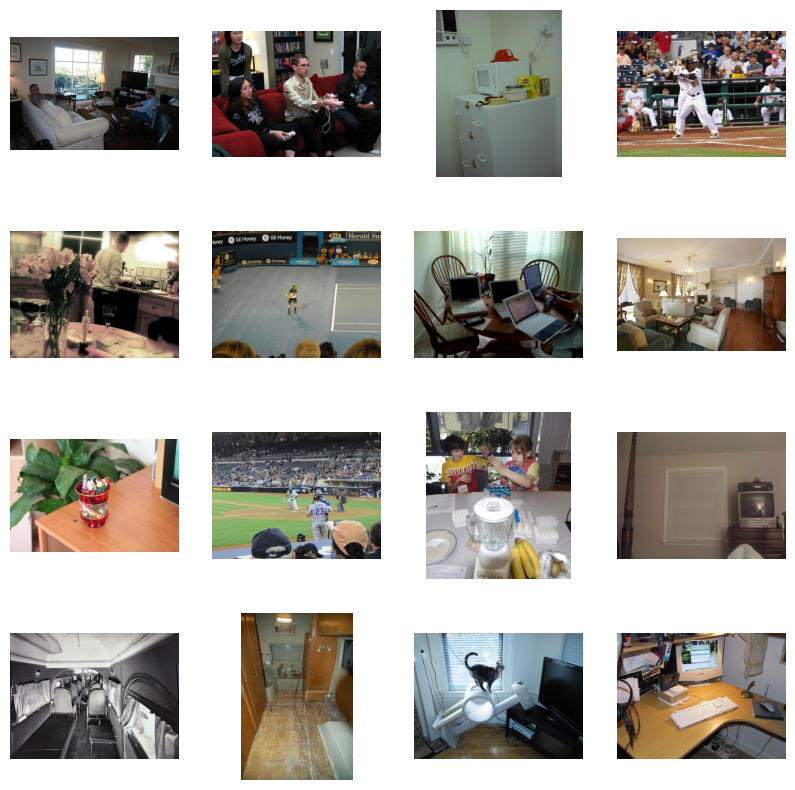

In [13]:
_, axes = plt.subplots(4, 4, figsize=(10, 10))
for ax, img_path in zip(axes.flatten(), train_paths):
    ax.imshow(Image.open(img_path))
    ax.axis("off")

In [14]:
SIZE = 256
class ColorizationDataset(Dataset):
    def __init__(self, paths, split='train'):
        if split == 'train':
            self.transforms = transforms.Compose([
                transforms.Resize((SIZE, SIZE),  Image.BICUBIC),
                transforms.RandomHorizontalFlip(), # A little data augmentation!
            ])
        elif split == 'val':
            self.transforms = transforms.Resize((SIZE, SIZE),  Image.BICUBIC)

        self.split = split
        self.size = SIZE
        self.paths = paths

    def __getitem__(self, idx):
        img = Image.open(self.paths[idx]).convert("RGB")
        img = self.transforms(img)
        img = np.array(img)
        img_lab = rgb2lab(img).astype("float32") # Converting RGB to L*a*b
        img_lab = transforms.ToTensor()(img_lab)
        L = img_lab[[0], ...] / 50. - 1. # Between -1 and 1
        ab = img_lab[[1, 2], ...] / 110. # Between -1 and 1

        return {'L': L, 'ab': ab}

    def __len__(self):
        return len(self.paths)

def make_dataloaders(batch_size=32, n_workers=4, pin_memory=True, **kwargs): # A handy function to make our dataloaders
    dataset = ColorizationDataset(**kwargs)
    dataloader = DataLoader(dataset, batch_size=batch_size, num_workers=n_workers,
                            pin_memory=pin_memory)
    return dataloader

In [15]:
train_dl = make_dataloaders(paths=train_paths, split='train')
val_dl = make_dataloaders(paths=val_paths, split='val')

data = next(iter(train_dl))
Ls, abs_ = data['L'], data['ab']
print(Ls.shape, abs_.shape)
print(len(train_dl), len(val_dl))

torch.Size([32, 1, 256, 256]) torch.Size([32, 2, 256, 256])
250 63


In [16]:
class UnetBlock(nn.Module):
    def __init__(self, nf, ni, submodule=None, input_c=None, dropout=False,
                 innermost=False, outermost=False):
        super().__init__()
        self.outermost = outermost
        if input_c is None: input_c = nf
        downconv = nn.Conv2d(input_c, ni, kernel_size=4,
                             stride=2, padding=1, bias=False)
        downrelu = nn.LeakyReLU(0.2, True)
        downnorm = nn.BatchNorm2d(ni)
        uprelu = nn.ReLU(True)
        upnorm = nn.BatchNorm2d(nf)

        if outermost:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1)
            down = [downconv]
            up = [uprelu, upconv, nn.Tanh()]
            model = down + [submodule] + up
        elif innermost:
            upconv = nn.ConvTranspose2d(ni, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv]
            up = [uprelu, upconv, upnorm]
            model = down + up
        else:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv, downnorm]
            up = [uprelu, upconv, upnorm]
            if dropout: up += [nn.Dropout(0.5)]
            model = down + [submodule] + up
        self.model = nn.Sequential(*model)

    def forward(self, x):
        if self.outermost:
            return self.model(x)
        else:
            return torch.cat([x, self.model(x)], 1)

class Unet(nn.Module):
    def __init__(self, input_c=1, output_c=2, n_down=8, num_filters=64):
        super().__init__()
        unet_block = UnetBlock(num_filters * 8, num_filters * 8, innermost=True)
        for _ in range(n_down - 5):
            unet_block = UnetBlock(num_filters * 8, num_filters * 8, submodule=unet_block, dropout=True)
        out_filters = num_filters * 8
        for _ in range(3):
            unet_block = UnetBlock(out_filters // 2, out_filters, submodule=unet_block)
            out_filters //= 2
        self.model = UnetBlock(output_c, out_filters, input_c=input_c, submodule=unet_block, outermost=True)

    def forward(self, x):
        return self.model(x)

In [17]:
class PatchDiscriminator(nn.Module):
    def __init__(self, input_c, num_filters=64, n_down=3):
        super().__init__()
        model = [self.get_layers(input_c, num_filters, norm=False)]
        model += [self.get_layers(num_filters * 2 ** i, num_filters * 2 ** (i + 1), s=1 if i == (n_down-1) else 2)
                          for i in range(n_down)] # the 'if' statement is taking care of not using
                                                  # stride of 2 for the last block in this loop
        model += [self.get_layers(num_filters * 2 ** n_down, 1, s=1, norm=False, act=False)] # Make sure to not use normalization or
                                                                                             # activation for the last layer of the model
        self.model = nn.Sequential(*model)

    def get_layers(self, ni, nf, k=4, s=2, p=1, norm=True, act=True): # when needing to make some repeatitive blocks of layers,
        layers = [nn.Conv2d(ni, nf, k, s, p, bias=not norm)]          # it's always helpful to make a separate method for that purpose
        if norm: layers += [nn.BatchNorm2d(nf)]
        if act: layers += [nn.LeakyReLU(0.2, True)]
        return nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)

In [18]:
PatchDiscriminator(3)

PatchDiscriminator(
  (model): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (3): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (

In [19]:
discriminator = PatchDiscriminator(3)
dummy_input = torch.randn(32, 3, 256, 256) # batch_size, channels, size, size
out = discriminator(dummy_input)
out.shape

torch.Size([32, 1, 30, 30])

In [20]:
class GANLoss(nn.Module):
    def __init__(self, gan_mode='vanilla', real_label=1.0, fake_label=0.0):
        super().__init__()
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
        if gan_mode == 'vanilla':
            self.loss = nn.BCEWithLogitsLoss()
        elif gan_mode == 'lsgan':
            self.loss = nn.MSELoss()

    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds)

    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

In [21]:
def init_weights(net, init='norm', gain=0.02):

    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            if init == 'norm':
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')

            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)

    net.apply(init_func)
    print(f"model initialized with {init} initialization")
    return net

def init_model(model, device):
    model = model.to(device)
    model = init_weights(model)
    return model

In [22]:
class MainModel(nn.Module):
    def __init__(self, net_G=None, lr_G=2e-4, lr_D=2e-4,
                 beta1=0.5, beta2=0.999, lambda_L1=100.):
        super().__init__()

        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1

        if net_G is None:
            self.net_G = init_model(Unet(input_c=1, output_c=2, n_down=8, num_filters=64), self.device)
        else:
            self.net_G = net_G.to(self.device)
        self.net_D = init_model(PatchDiscriminator(input_c=3, n_down=3, num_filters=64), self.device)
        self.GANcriterion = GANLoss(gan_mode='vanilla').to(self.device)
        self.L1criterion = nn.L1Loss()
        self.opt_G = optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
        self.opt_D = optim.Adam(self.net_D.parameters(), lr=lr_D, betas=(beta1, beta2))

    def set_requires_grad(self, model, requires_grad=True):
        for p in model.parameters():
            p.requires_grad = requires_grad

    def set_requires_grad(self, model, requires_grad=True):
        for p in model.parameters():
            p.requires_grad = requires_grad

    def setup_input(self, data):
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)

    def get_images(self,image):
        self.L = image.to(self.device)

    def forward_data(self):
        self.fake_color = self.net_G(self.L)
        
    def forward(self,data):
        return self.net_G(data)

    def preocess_image(self, image):
        return self.net_G(image)

    def backward_D(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image.detach())
        self.loss_D_fake = self.GANcriterion(fake_preds, False)
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.net_D(real_image)
        self.loss_D_real = self.GANcriterion(real_preds, True)
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()

    def backward_G(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image)
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()

    def optimize(self):
        self.forward_data()
        self.net_D.train()
        self.set_requires_grad(self.net_D, True)
        self.opt_D.zero_grad()
        self.backward_D()
        self.opt_D.step()

        self.net_G.train()
        self.set_requires_grad(self.net_D, False)
        self.opt_G.zero_grad()
        self.backward_G()
        self.opt_G.step()

In [23]:
class AverageMeter:
    def __init__(self):
        self.reset()

    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3

    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

def create_loss_meters():
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()

    return {'loss_D_fake': loss_D_fake,
            'loss_D_real': loss_D_real,
            'loss_D': loss_D,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}

def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)

def lab_to_rgb(L, ab):
    """
    Takes a batch of images
    """

    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)

def visualize(model, data, save=True):
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward_data()
    model.net_G.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
    plt.show()
#     if save:
#         fig.savefig(f"colorization_{time.time()}.png")

def log_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")

In [24]:
from tqdm.auto import tqdm

In [25]:
def train_model(model, train_dl, epochs, display_every=40, save_every=5, save_path='model_checkpoint.pth'):
    data = next(iter(val_dl)) # getting a batch for visualizing the model output after fixed intervals
    for e in range(epochs):
        loss_meter_dict = create_loss_meters() # function returning a dictionary of objects to
        i = 0                                  # log the losses of the complete network
        for data in tqdm(train_dl):
            model.setup_input(data)
            model.optimize()
            update_losses(model, loss_meter_dict, count=data['L'].size(0)) # function updating the log objects
            i += 1
            if i % display_every == 0:
                print(f"\nEpoch {e+1}/{epochs}")
                print(f"Iteration {i}/{len(train_dl)}")
                log_results(loss_meter_dict) # function to print out the losses
                visualize(model, data, save=True) # function displaying the model's outputs
            if i % save_every == 0:
                torch.save(model.state_dict(), save_path)
                print(f"Model saved at iteration {i} of epoch {e+1}")

In [26]:
model = MainModel()
print(summary(model,(1,256,256)))

model initialized with norm initialization
model initialized with norm initialization
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 128, 128]           1,024
         LeakyReLU-2         [-1, 64, 128, 128]               0
            Conv2d-3          [-1, 128, 64, 64]         131,072
       BatchNorm2d-4          [-1, 128, 64, 64]             256
         LeakyReLU-5          [-1, 128, 64, 64]               0
            Conv2d-6          [-1, 256, 32, 32]         524,288
       BatchNorm2d-7          [-1, 256, 32, 32]             512
         LeakyReLU-8          [-1, 256, 32, 32]               0
            Conv2d-9          [-1, 512, 16, 16]       2,097,152
      BatchNorm2d-10          [-1, 512, 16, 16]           1,024
        LeakyReLU-11          [-1, 512, 16, 16]               0
           Conv2d-12            [-1, 512, 8, 8]       4,194,304
      BatchNorm2d

In [30]:
state_dict = torch.load('/kaggle/input/base-model-weights/model_checkpoint.pth')
model.load_state_dict(state_dict)

<All keys matched successfully>

  0%|          | 0/250 [00:00<?, ?it/s]

Model saved at iteration 10 of epoch 1
Model saved at iteration 20 of epoch 1
Model saved at iteration 30 of epoch 1

Epoch 1/10
Iteration 40/250
loss_D_fake: 1.70897
loss_D_real: 1.25800
loss_D: 1.48349
loss_G_GAN: 1.60403
loss_G_L1: 5.32425
loss_G: 6.92828


/tmp/ipykernel_34/2912172730.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 4 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
/tmp/ipykernel_34/2912172730.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 3 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
/tmp/ipykernel_34/2912172730.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 10 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
/tmp/ipykernel_34/2912172730.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 2 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


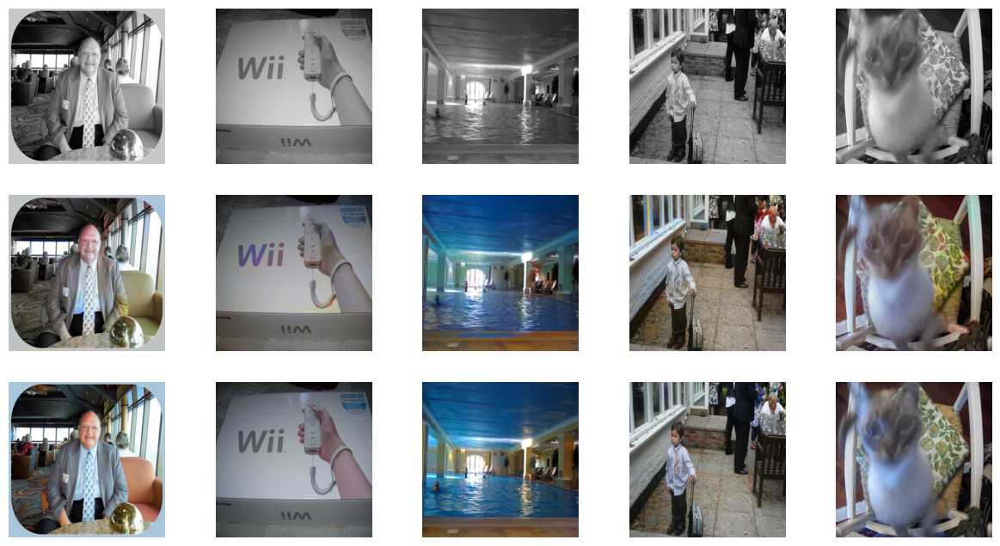

Model saved at iteration 40 of epoch 1
Model saved at iteration 50 of epoch 1
Model saved at iteration 60 of epoch 1
Model saved at iteration 70 of epoch 1

Epoch 1/10
Iteration 80/250
loss_D_fake: 1.18185
loss_D_real: 0.96426
loss_D: 1.07305
loss_G_GAN: 1.48410
loss_G_L1: 5.36106
loss_G: 6.84516


/tmp/ipykernel_34/2912172730.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 1 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


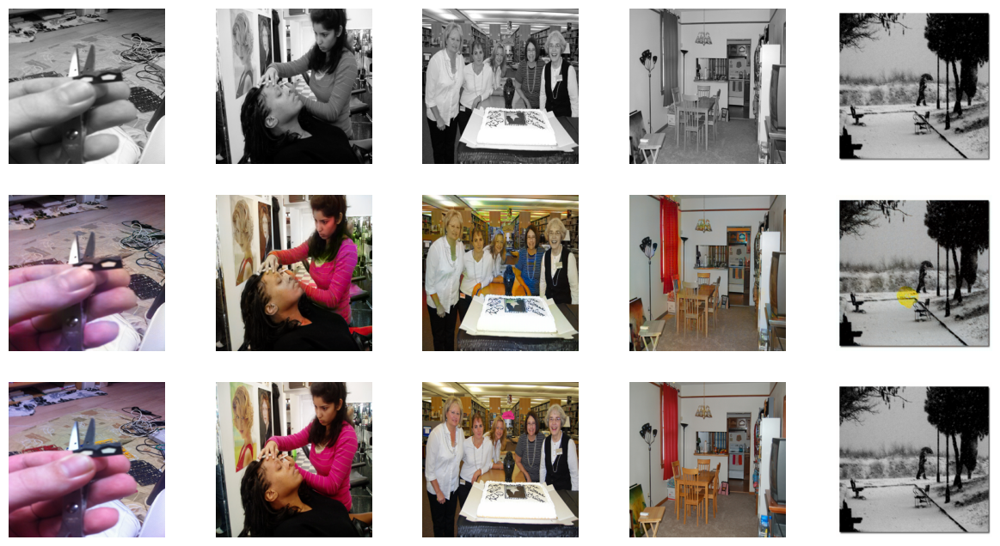

Model saved at iteration 80 of epoch 1
Model saved at iteration 90 of epoch 1
Model saved at iteration 100 of epoch 1
Model saved at iteration 110 of epoch 1

Epoch 1/10
Iteration 120/250
loss_D_fake: 0.95949
loss_D_real: 0.80683
loss_D: 0.88316
loss_G_GAN: 1.54236
loss_G_L1: 5.41851
loss_G: 6.96087


/tmp/ipykernel_34/2912172730.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 6 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
/tmp/ipykernel_34/2912172730.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 170 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


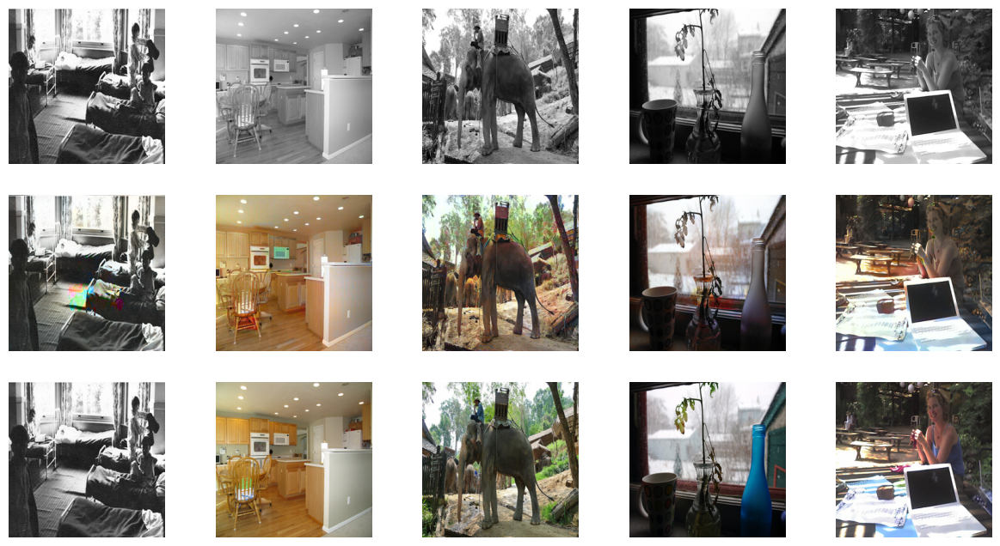

Model saved at iteration 120 of epoch 1
Model saved at iteration 130 of epoch 1
Model saved at iteration 140 of epoch 1
Model saved at iteration 150 of epoch 1

Epoch 1/10
Iteration 160/250
loss_D_fake: 0.83121
loss_D_real: 0.71349
loss_D: 0.77235
loss_G_GAN: 1.60802
loss_G_L1: 5.47763
loss_G: 7.08565


/tmp/ipykernel_34/2912172730.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 35 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
/tmp/ipykernel_34/2912172730.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 122 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
/tmp/ipykernel_34/2912172730.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 9 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
/tmp/ipykernel_34/2912172730.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 5 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


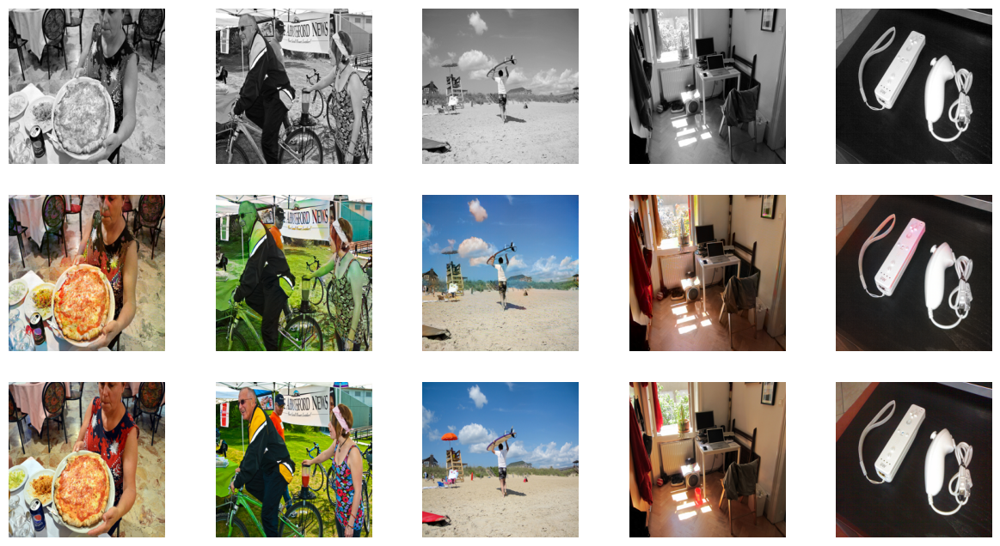

Model saved at iteration 160 of epoch 1
Model saved at iteration 170 of epoch 1
Model saved at iteration 180 of epoch 1
Model saved at iteration 190 of epoch 1

Epoch 1/10
Iteration 200/250
loss_D_fake: 0.74636
loss_D_real: 0.65678
loss_D: 0.70157
loss_G_GAN: 1.61737
loss_G_L1: 5.46818
loss_G: 7.08555


/tmp/ipykernel_34/2912172730.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 12 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


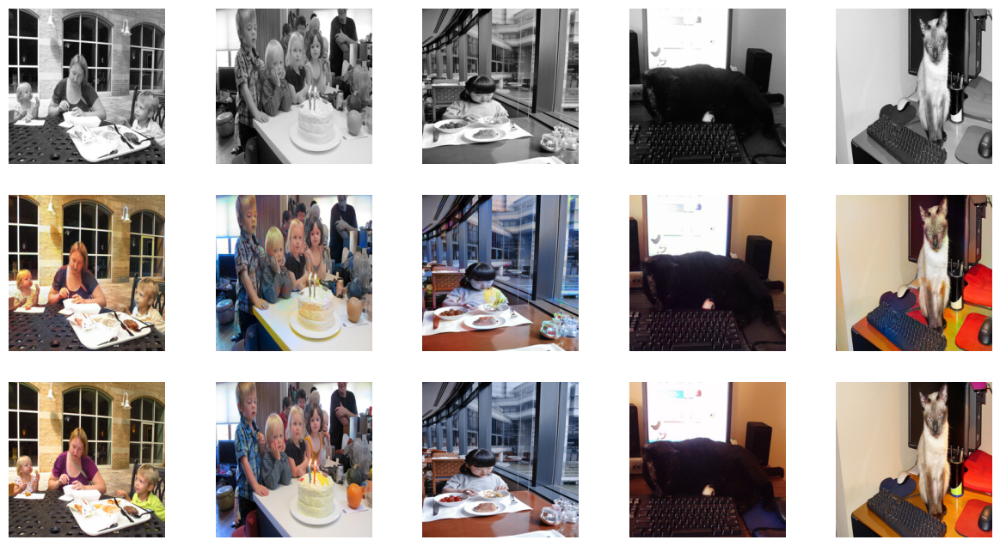

Model saved at iteration 200 of epoch 1
Model saved at iteration 210 of epoch 1
Model saved at iteration 220 of epoch 1
Model saved at iteration 230 of epoch 1

Epoch 1/10
Iteration 240/250
loss_D_fake: 0.69187
loss_D_real: 0.61671
loss_D: 0.65429
loss_G_GAN: 1.63241
loss_G_L1: 5.47392
loss_G: 7.10633


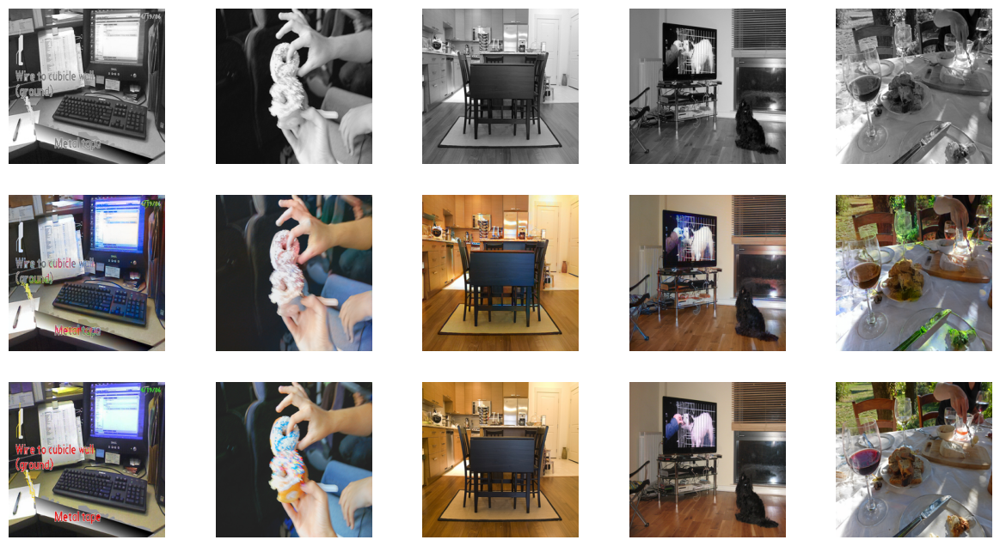

Model saved at iteration 240 of epoch 1
Model saved at iteration 250 of epoch 1


  0%|          | 0/250 [00:00<?, ?it/s]

Model saved at iteration 10 of epoch 2
Model saved at iteration 20 of epoch 2
Model saved at iteration 30 of epoch 2

Epoch 2/10
Iteration 40/250
loss_D_fake: 0.49291
loss_D_real: 0.45322
loss_D: 0.47306
loss_G_GAN: 1.75435
loss_G_L1: 5.45651
loss_G: 7.21086


/tmp/ipykernel_34/2912172730.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 7 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


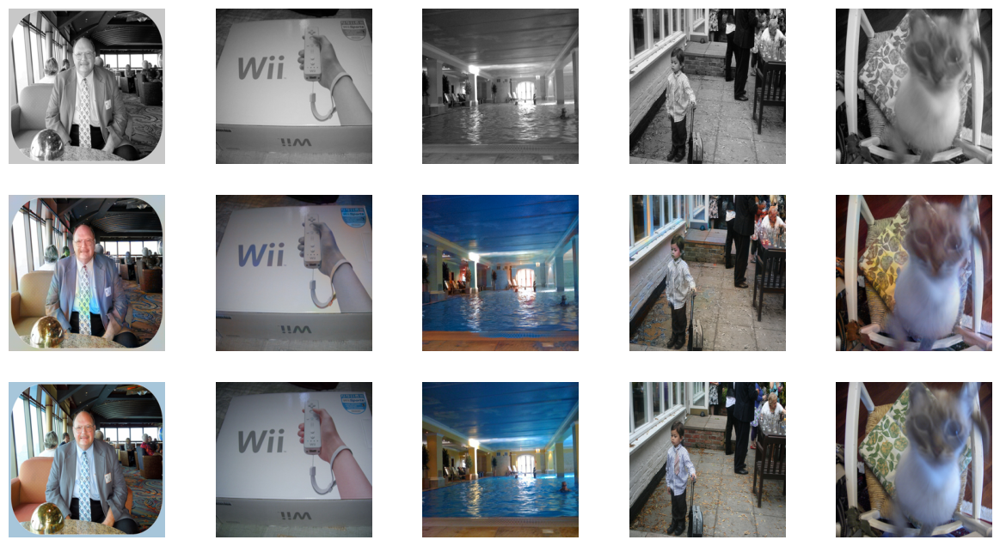

Model saved at iteration 40 of epoch 2
Model saved at iteration 50 of epoch 2
Model saved at iteration 60 of epoch 2
Model saved at iteration 70 of epoch 2

Epoch 2/10
Iteration 80/250
loss_D_fake: 0.48587
loss_D_real: 0.46594
loss_D: 0.47590
loss_G_GAN: 1.73920
loss_G_L1: 5.47680
loss_G: 7.21600


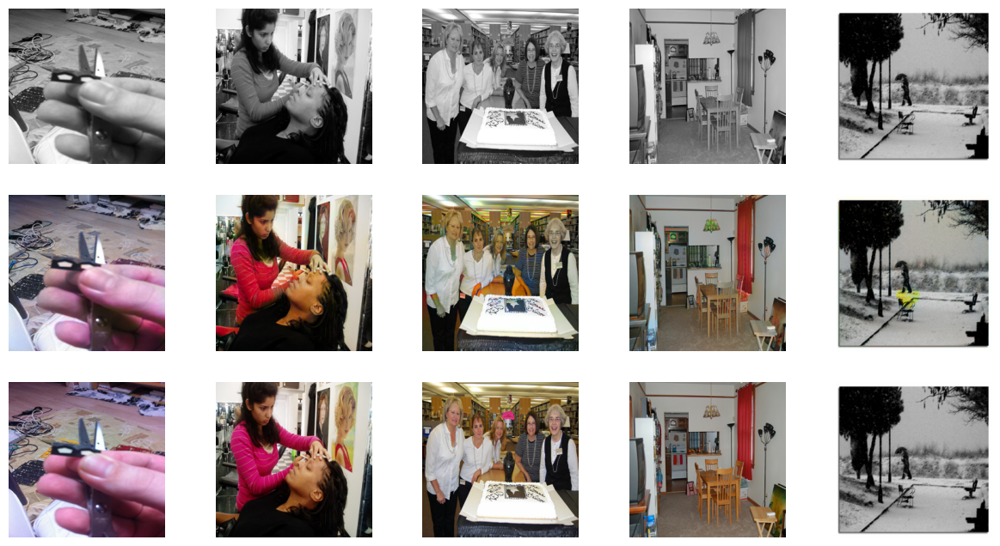

Model saved at iteration 80 of epoch 2
Model saved at iteration 90 of epoch 2
Model saved at iteration 100 of epoch 2
Model saved at iteration 110 of epoch 2

Epoch 2/10
Iteration 120/250
loss_D_fake: 0.45906
loss_D_real: 0.44192
loss_D: 0.45049
loss_G_GAN: 1.73930
loss_G_L1: 5.47188
loss_G: 7.21118


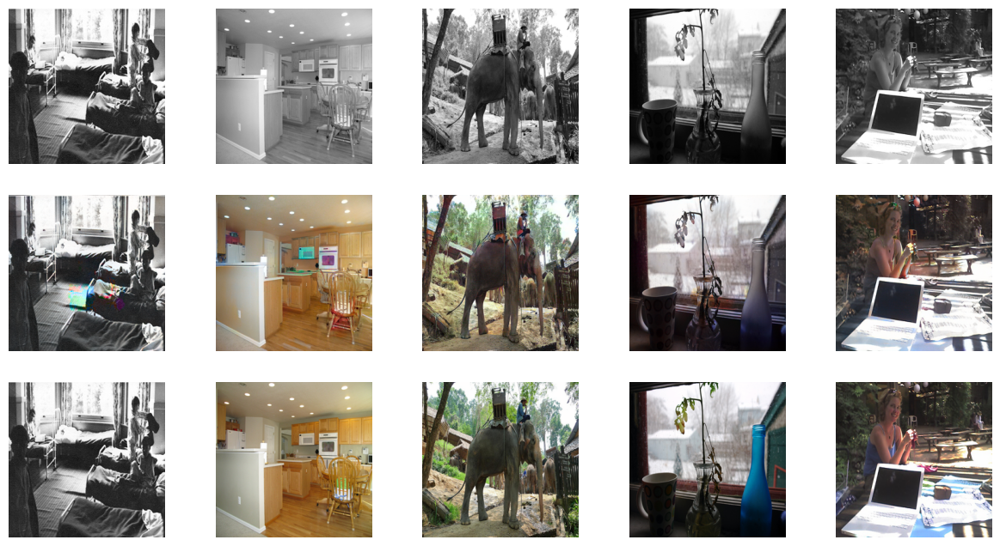

Model saved at iteration 120 of epoch 2
Model saved at iteration 130 of epoch 2
Model saved at iteration 140 of epoch 2
Model saved at iteration 150 of epoch 2

Epoch 2/10
Iteration 160/250
loss_D_fake: 0.47917
loss_D_real: 0.45173
loss_D: 0.46545
loss_G_GAN: 1.74458
loss_G_L1: 5.49914
loss_G: 7.24373


/tmp/ipykernel_34/2912172730.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 8 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
/tmp/ipykernel_34/2912172730.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 111 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


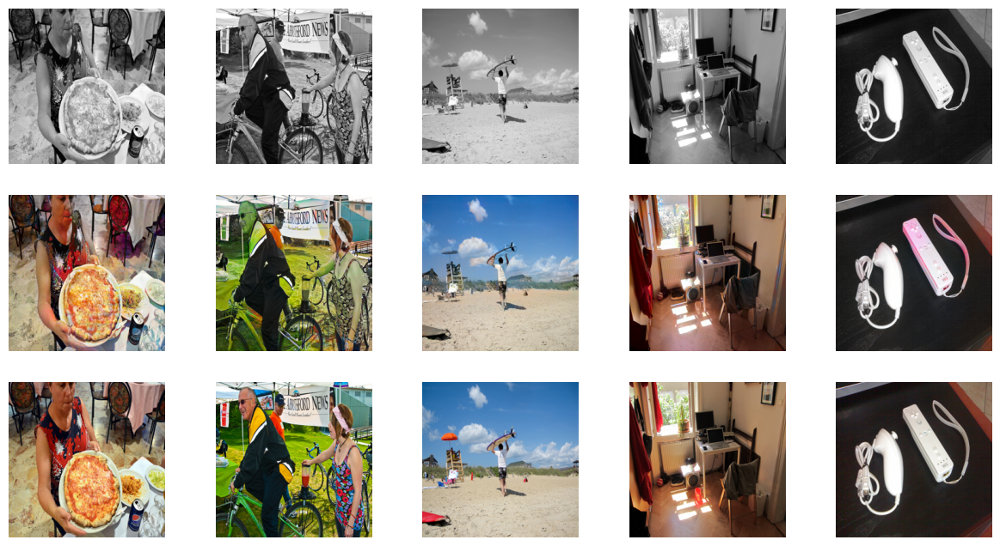

Model saved at iteration 160 of epoch 2
Model saved at iteration 170 of epoch 2
Model saved at iteration 180 of epoch 2
Model saved at iteration 190 of epoch 2

Epoch 2/10
Iteration 200/250
loss_D_fake: 0.46693
loss_D_real: 0.44821
loss_D: 0.45757
loss_G_GAN: 1.72042
loss_G_L1: 5.47732
loss_G: 7.19774


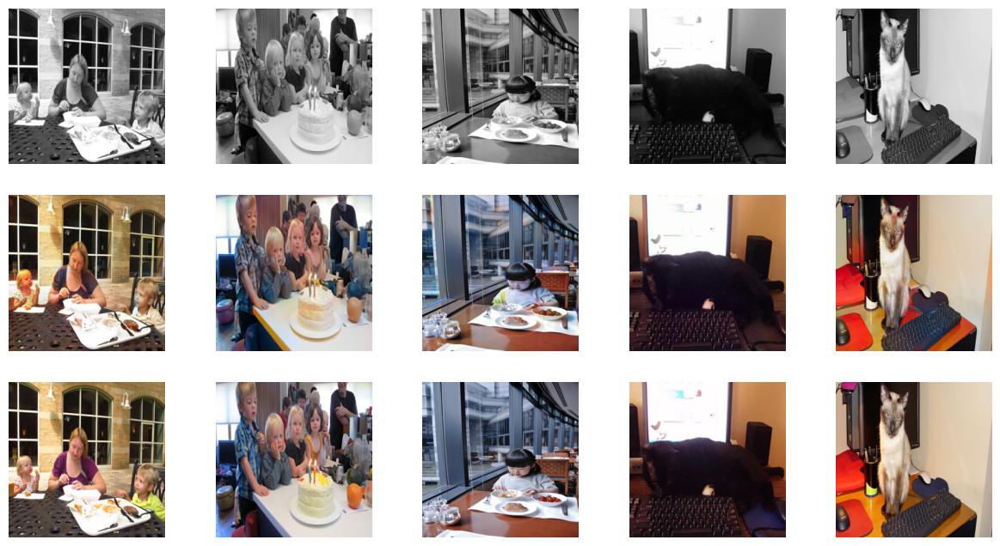

Model saved at iteration 200 of epoch 2
Model saved at iteration 210 of epoch 2
Model saved at iteration 220 of epoch 2
Model saved at iteration 230 of epoch 2

Epoch 2/10
Iteration 240/250
loss_D_fake: 0.45512
loss_D_real: 0.43817
loss_D: 0.44664
loss_G_GAN: 1.71534
loss_G_L1: 5.47672
loss_G: 7.19206


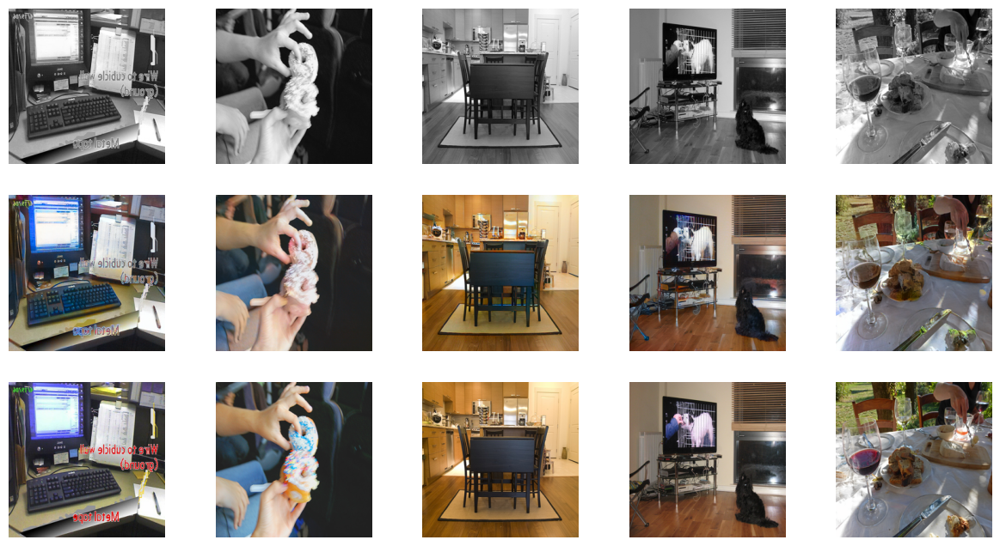

Model saved at iteration 240 of epoch 2
Model saved at iteration 250 of epoch 2


  0%|          | 0/250 [00:00<?, ?it/s]

Model saved at iteration 10 of epoch 3
Model saved at iteration 20 of epoch 3
Model saved at iteration 30 of epoch 3

Epoch 3/10
Iteration 40/250
loss_D_fake: 0.51446
loss_D_real: 0.47747
loss_D: 0.49597
loss_G_GAN: 1.77549
loss_G_L1: 5.37877
loss_G: 7.15426


/tmp/ipykernel_34/2912172730.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 37 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


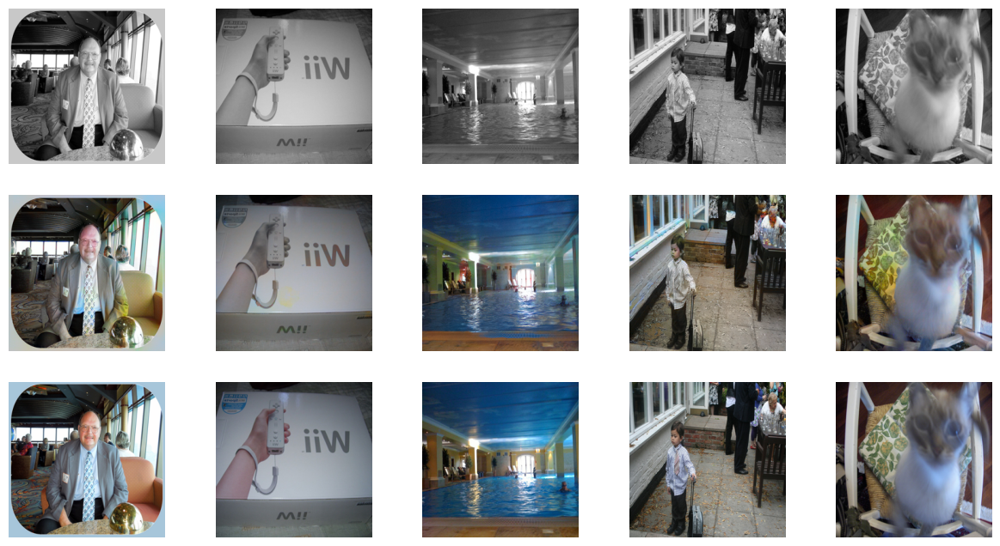

Model saved at iteration 40 of epoch 3
Model saved at iteration 50 of epoch 3
Model saved at iteration 60 of epoch 3
Model saved at iteration 70 of epoch 3

Epoch 3/10
Iteration 80/250
loss_D_fake: 0.46566
loss_D_real: 0.44790
loss_D: 0.45678
loss_G_GAN: 1.80796
loss_G_L1: 5.39925
loss_G: 7.20721


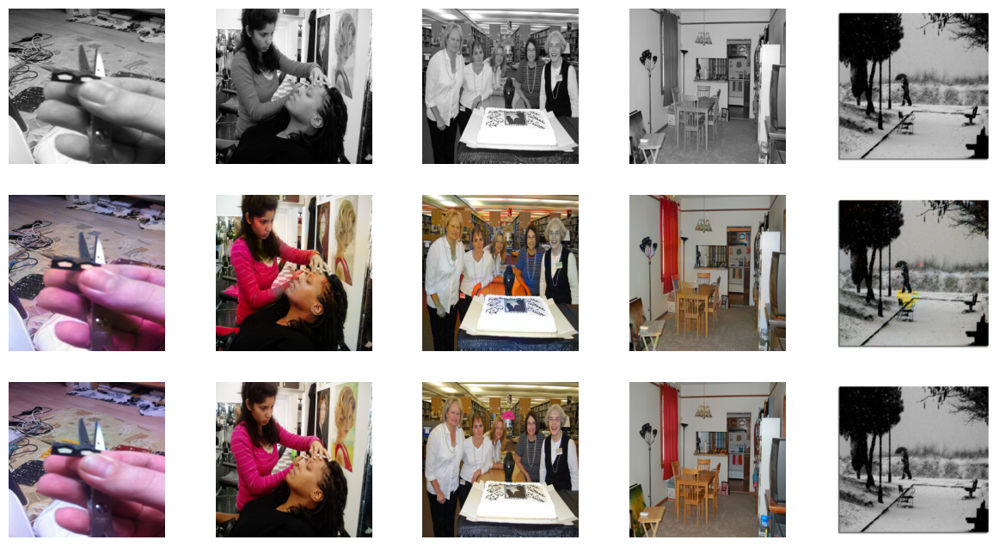

Model saved at iteration 80 of epoch 3
Model saved at iteration 90 of epoch 3
Model saved at iteration 100 of epoch 3
Model saved at iteration 110 of epoch 3

Epoch 3/10
Iteration 120/250
loss_D_fake: 0.45780
loss_D_real: 0.43579
loss_D: 0.44680
loss_G_GAN: 1.78148
loss_G_L1: 5.40874
loss_G: 7.19022


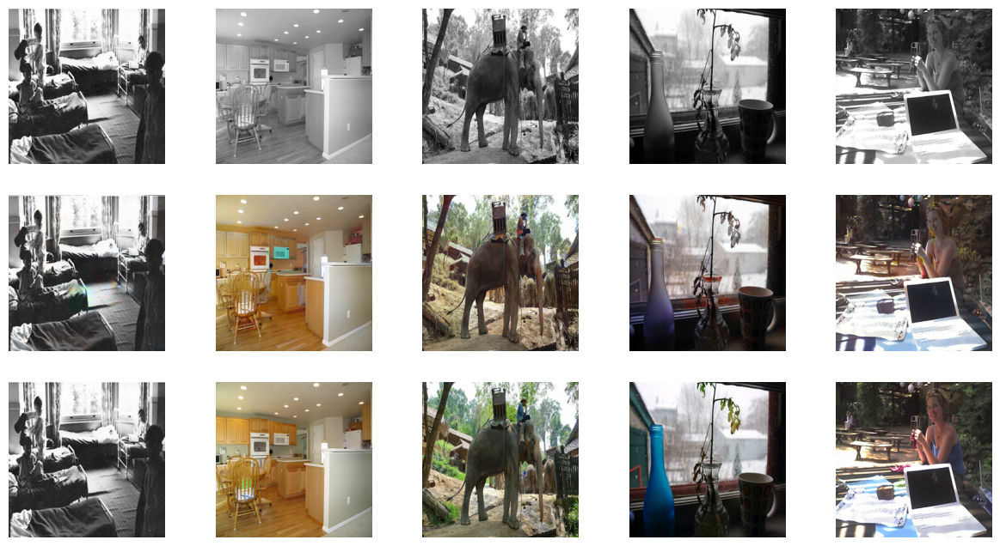

Model saved at iteration 120 of epoch 3
Model saved at iteration 130 of epoch 3
Model saved at iteration 140 of epoch 3
Model saved at iteration 150 of epoch 3

Epoch 3/10
Iteration 160/250
loss_D_fake: 0.45030
loss_D_real: 0.43061
loss_D: 0.44046
loss_G_GAN: 1.78373
loss_G_L1: 5.43625
loss_G: 7.21998


/tmp/ipykernel_34/2912172730.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 11 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


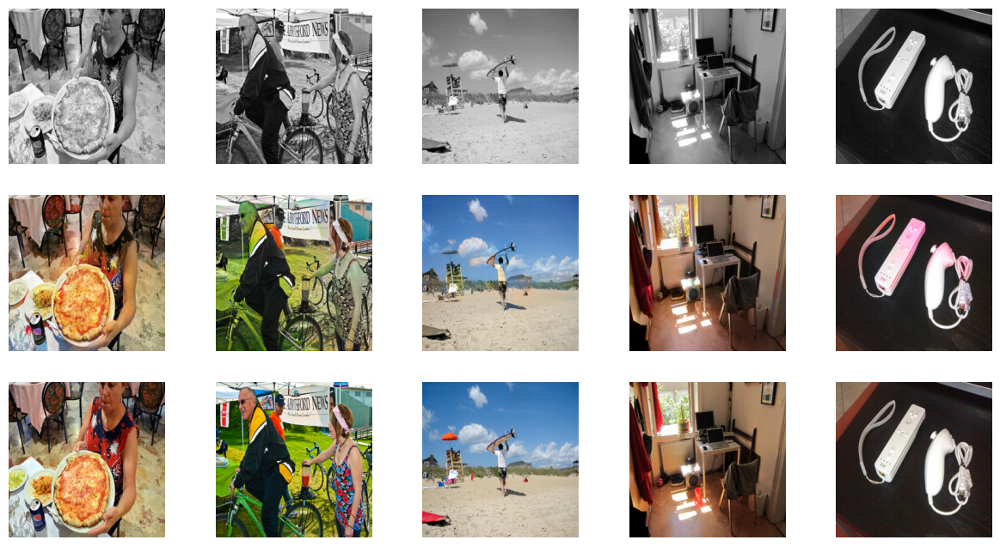

Model saved at iteration 160 of epoch 3
Model saved at iteration 170 of epoch 3
Model saved at iteration 180 of epoch 3
Model saved at iteration 190 of epoch 3

Epoch 3/10
Iteration 200/250
loss_D_fake: 0.45018
loss_D_real: 0.43498
loss_D: 0.44258
loss_G_GAN: 1.76798
loss_G_L1: 5.42166
loss_G: 7.18964


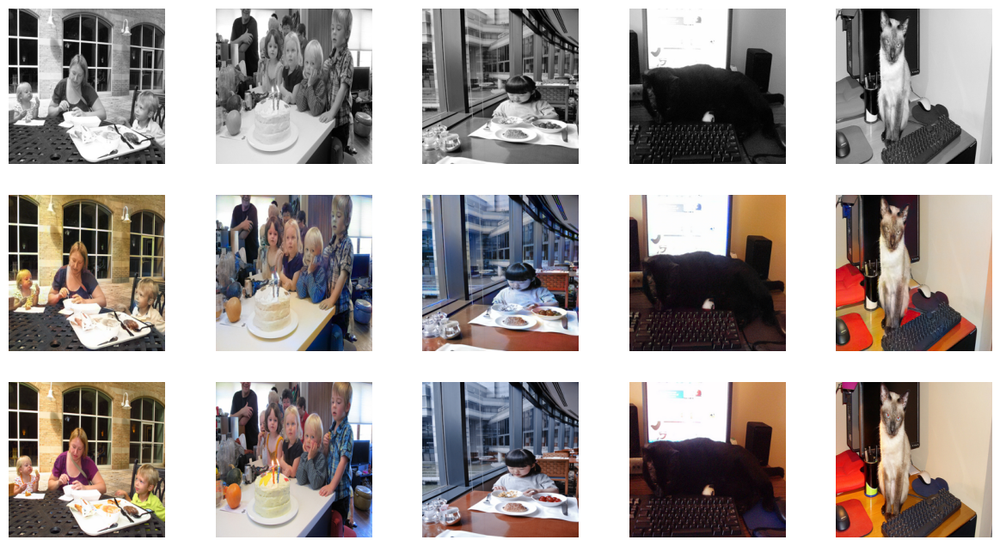

Model saved at iteration 200 of epoch 3
Model saved at iteration 210 of epoch 3
Model saved at iteration 220 of epoch 3
Model saved at iteration 230 of epoch 3

Epoch 3/10
Iteration 240/250
loss_D_fake: 0.44488
loss_D_real: 0.42886
loss_D: 0.43687
loss_G_GAN: 1.75695
loss_G_L1: 5.41731
loss_G: 7.17426


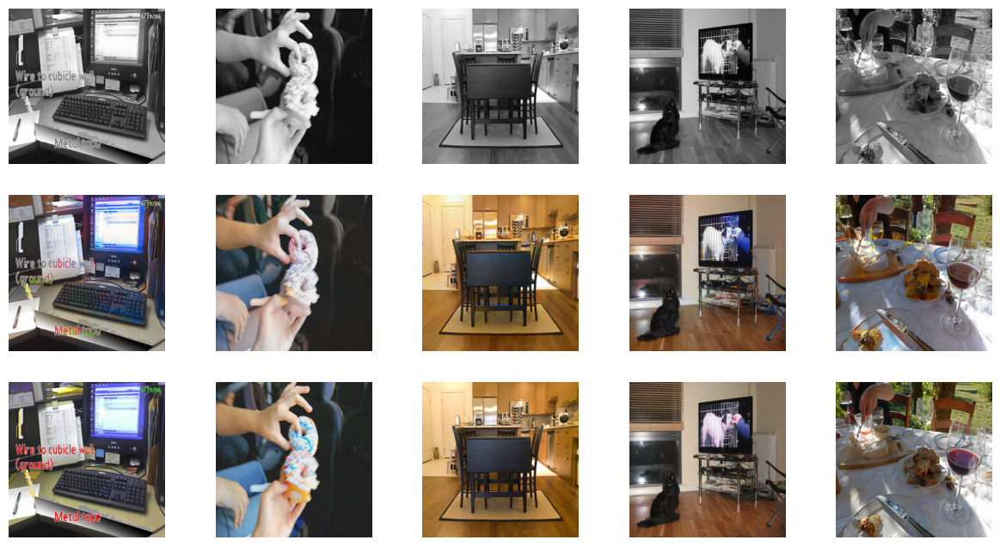

Model saved at iteration 240 of epoch 3
Model saved at iteration 250 of epoch 3


  0%|          | 0/250 [00:00<?, ?it/s]

Model saved at iteration 10 of epoch 4
Model saved at iteration 20 of epoch 4
Model saved at iteration 30 of epoch 4

Epoch 4/10
Iteration 40/250
loss_D_fake: 0.98484
loss_D_real: 0.92727
loss_D: 0.95606
loss_G_GAN: 1.98203
loss_G_L1: 5.33828
loss_G: 7.32031


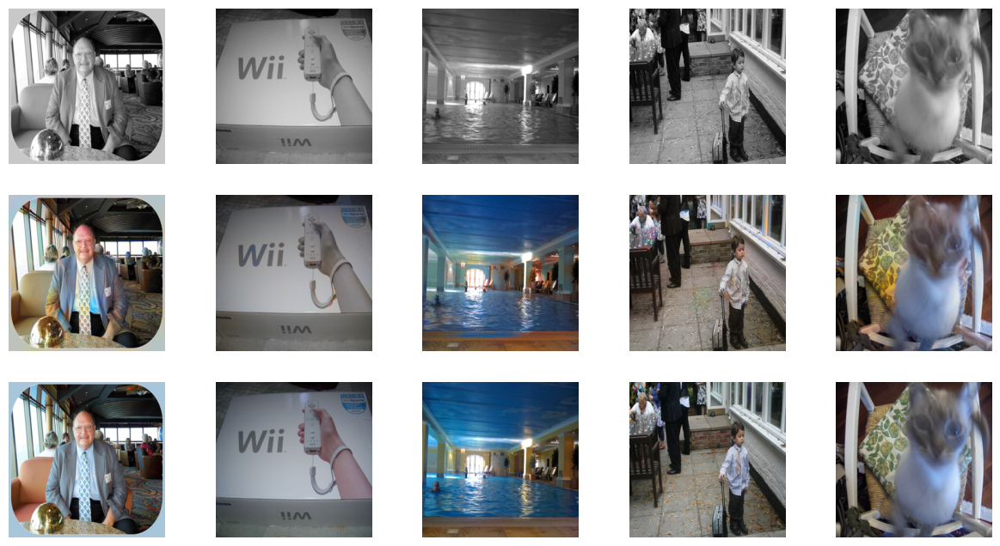

Model saved at iteration 40 of epoch 4
Model saved at iteration 50 of epoch 4
Model saved at iteration 60 of epoch 4
Model saved at iteration 70 of epoch 4

Epoch 4/10
Iteration 80/250
loss_D_fake: 0.72011
loss_D_real: 0.68073
loss_D: 0.70042
loss_G_GAN: 1.79680
loss_G_L1: 5.36319
loss_G: 7.15999


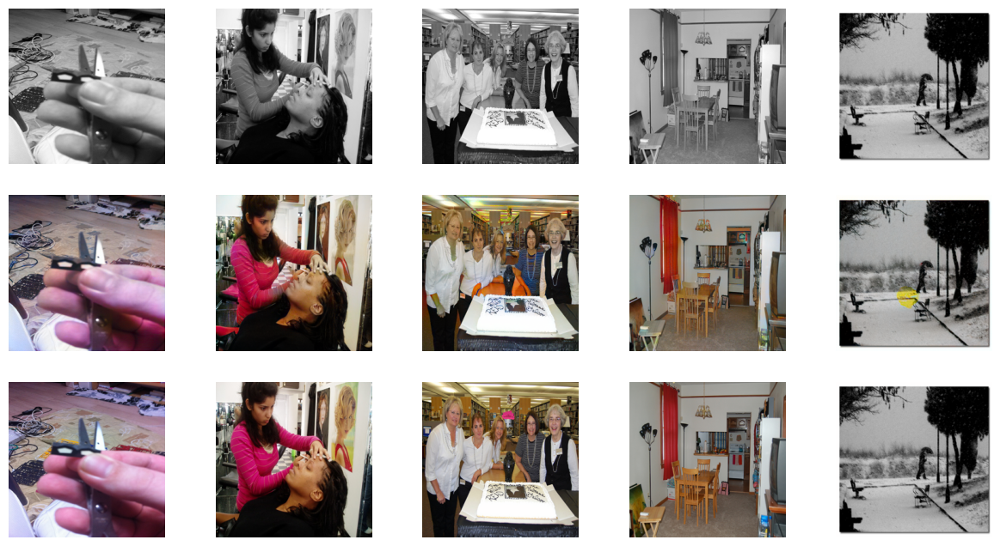

Model saved at iteration 80 of epoch 4
Model saved at iteration 90 of epoch 4
Model saved at iteration 100 of epoch 4
Model saved at iteration 110 of epoch 4

Epoch 4/10
Iteration 120/250
loss_D_fake: 0.63158
loss_D_real: 0.59896
loss_D: 0.61527
loss_G_GAN: 1.73327
loss_G_L1: 5.36669
loss_G: 7.09996


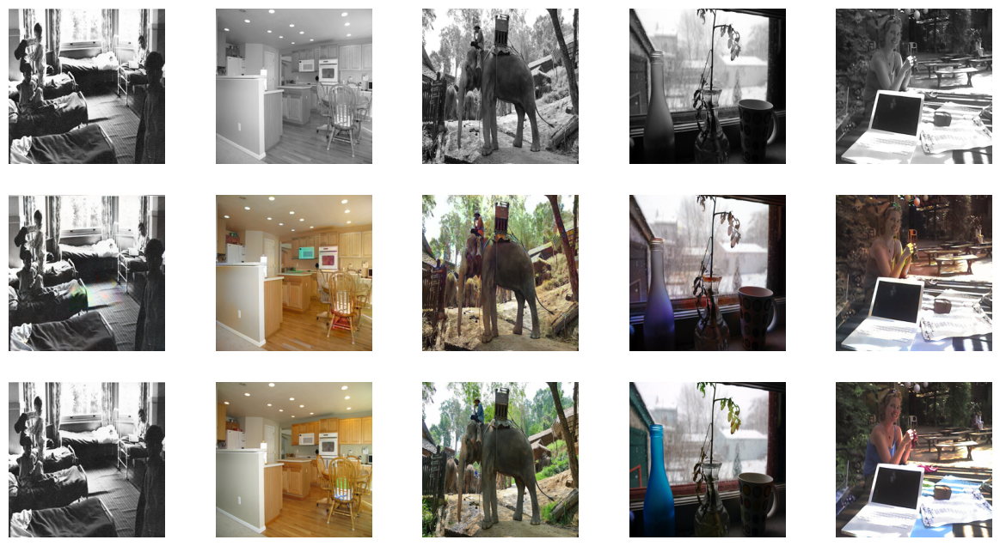

Model saved at iteration 120 of epoch 4
Model saved at iteration 130 of epoch 4
Model saved at iteration 140 of epoch 4
Model saved at iteration 150 of epoch 4

Epoch 4/10
Iteration 160/250
loss_D_fake: 0.58851
loss_D_real: 0.55492
loss_D: 0.57171
loss_G_GAN: 1.70822
loss_G_L1: 5.39784
loss_G: 7.10606


/tmp/ipykernel_34/2912172730.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 23 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


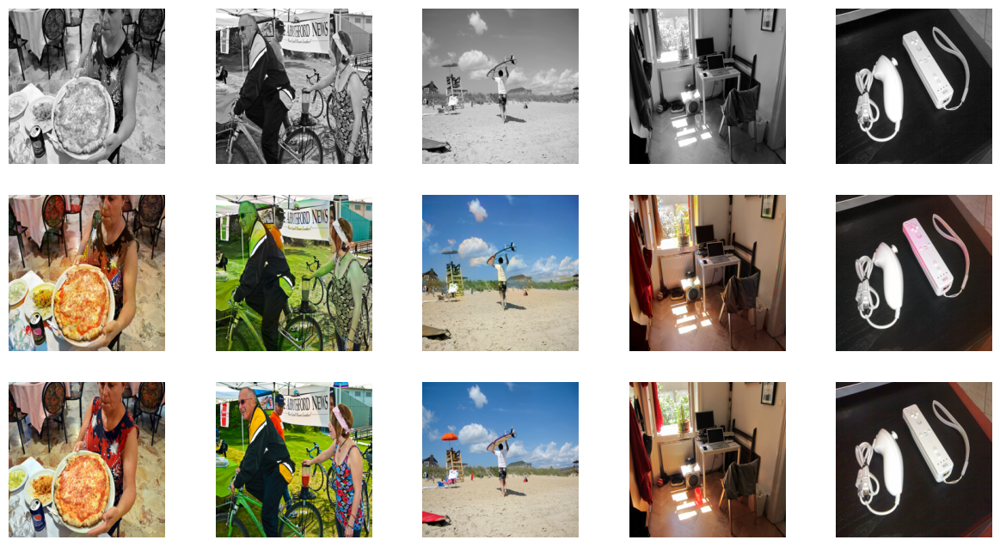

Model saved at iteration 160 of epoch 4
Model saved at iteration 170 of epoch 4
Model saved at iteration 180 of epoch 4
Model saved at iteration 190 of epoch 4

Epoch 4/10
Iteration 200/250
loss_D_fake: 0.55616
loss_D_real: 0.53263
loss_D: 0.54440
loss_G_GAN: 1.68912
loss_G_L1: 5.38135
loss_G: 7.07047


/tmp/ipykernel_34/2912172730.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 15 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


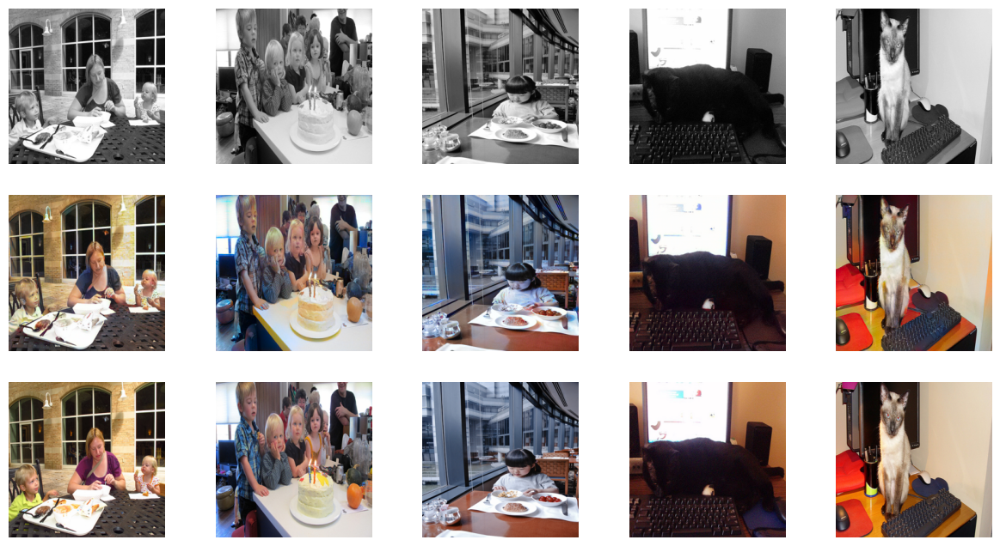

Model saved at iteration 200 of epoch 4
Model saved at iteration 210 of epoch 4
Model saved at iteration 220 of epoch 4
Model saved at iteration 230 of epoch 4

Epoch 4/10
Iteration 240/250
loss_D_fake: 0.53322
loss_D_real: 0.51262
loss_D: 0.52292
loss_G_GAN: 1.67357
loss_G_L1: 5.37806
loss_G: 7.05163


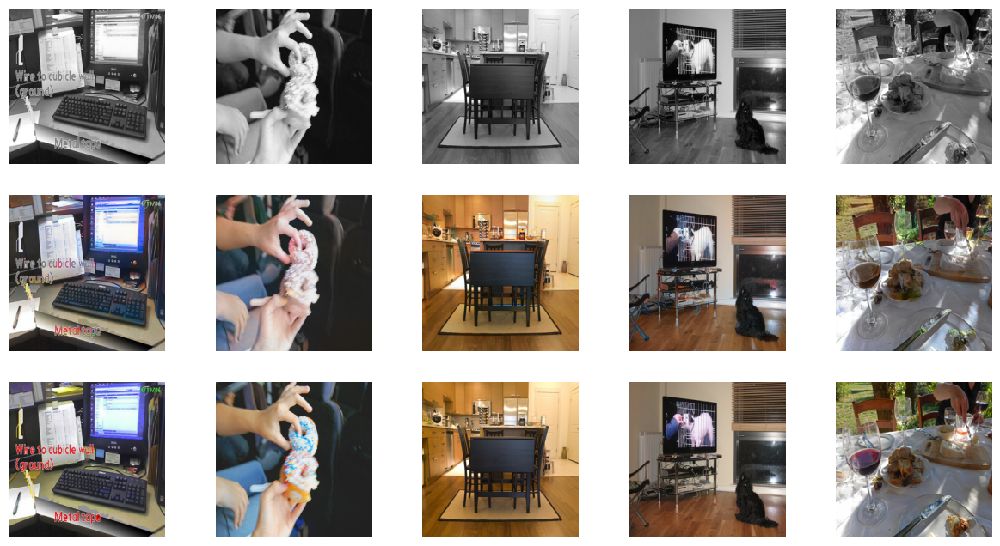

Model saved at iteration 240 of epoch 4
Model saved at iteration 250 of epoch 4


  0%|          | 0/250 [00:00<?, ?it/s]

Model saved at iteration 10 of epoch 5
Model saved at iteration 20 of epoch 5
Model saved at iteration 30 of epoch 5

Epoch 5/10
Iteration 40/250
loss_D_fake: 0.41955
loss_D_real: 0.41786
loss_D: 0.41871
loss_G_GAN: 1.76071
loss_G_L1: 5.35175
loss_G: 7.11246


/tmp/ipykernel_34/2912172730.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 13 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


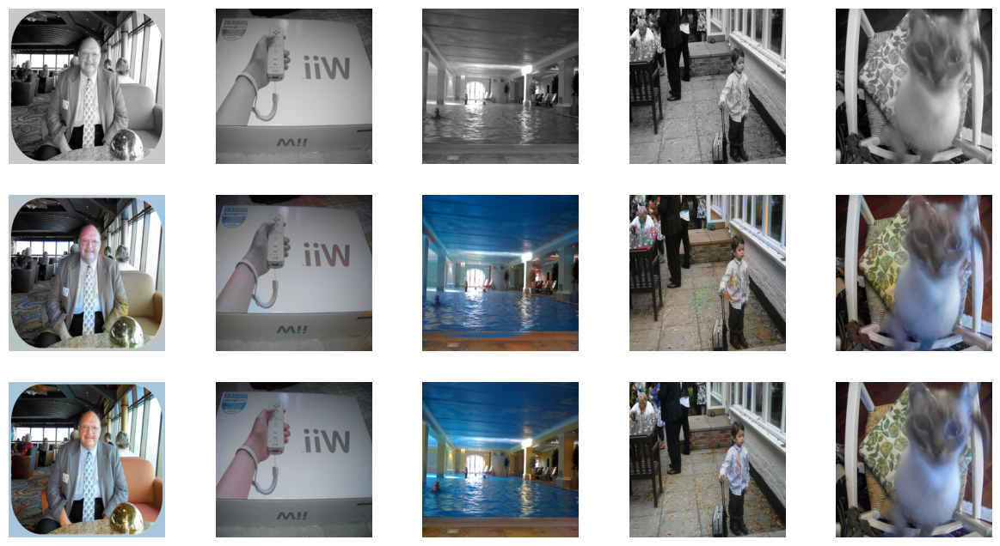

Model saved at iteration 40 of epoch 5
Model saved at iteration 50 of epoch 5
Model saved at iteration 60 of epoch 5
Model saved at iteration 70 of epoch 5

Epoch 5/10
Iteration 80/250
loss_D_fake: 0.41897
loss_D_real: 0.41626
loss_D: 0.41762
loss_G_GAN: 1.75321
loss_G_L1: 5.37057
loss_G: 7.12378


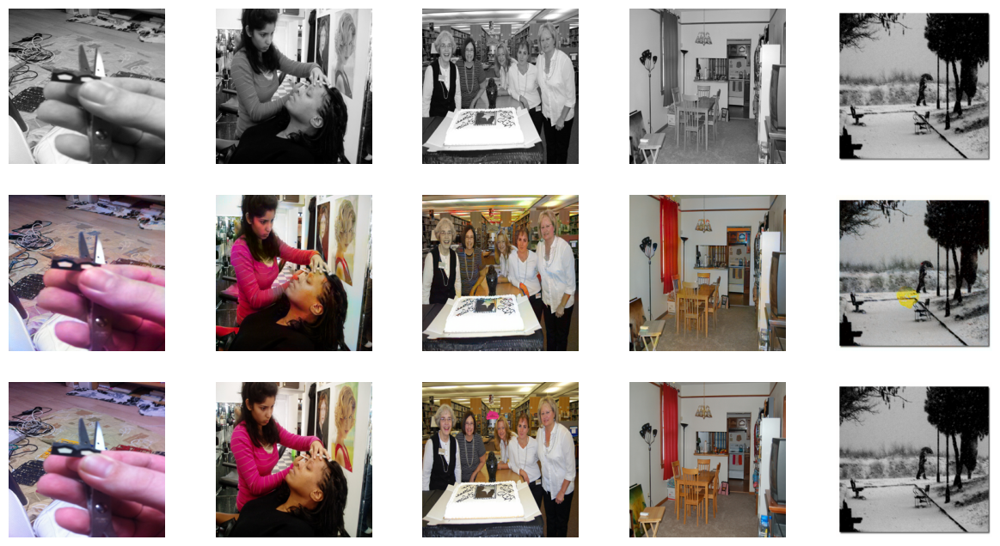

Model saved at iteration 80 of epoch 5
Model saved at iteration 90 of epoch 5
Model saved at iteration 100 of epoch 5
Model saved at iteration 110 of epoch 5

Epoch 5/10
Iteration 120/250
loss_D_fake: 0.44762
loss_D_real: 0.43919
loss_D: 0.44340
loss_G_GAN: 1.75559
loss_G_L1: 5.34814
loss_G: 7.10374


In [ ]:
# train_model(model, train_dl, 10, save_every=10, save_path='model_checkpoint.pth')

In [23]:
model.device

device(type='cuda')

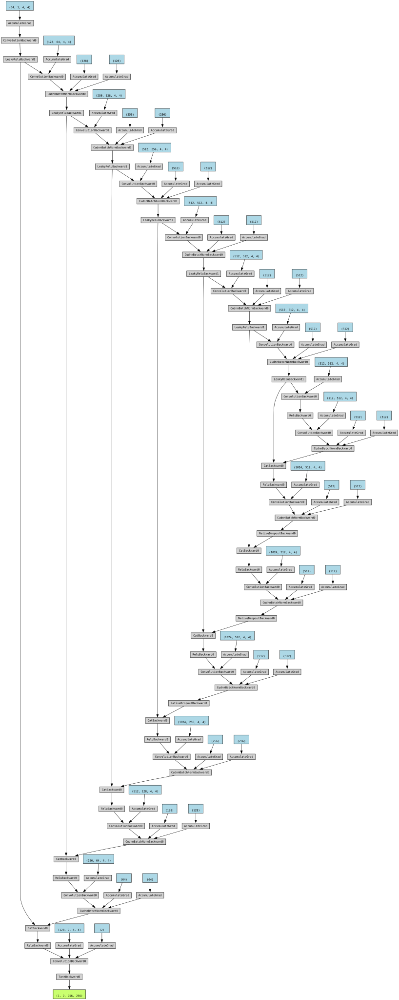

In [47]:
# state_dict = torch.load('/kaggle/working/model_checkpoint.pth')
# model.load_state_dict(state_dict)


x = torch.zeros(1, 1, 256, 256, dtype=torch.float, requires_grad=False).to(device)
out = model(x)
make_dot(out, params=dict(list(model.named_parameters()))).render("unet-gan", format="png")

dot = make_dot(out)
dot.save('model_graph.jpeg')
make_dot(out)

0it [00:00, ?it/s]

/tmp/ipykernel_34/2912172730.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 1 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


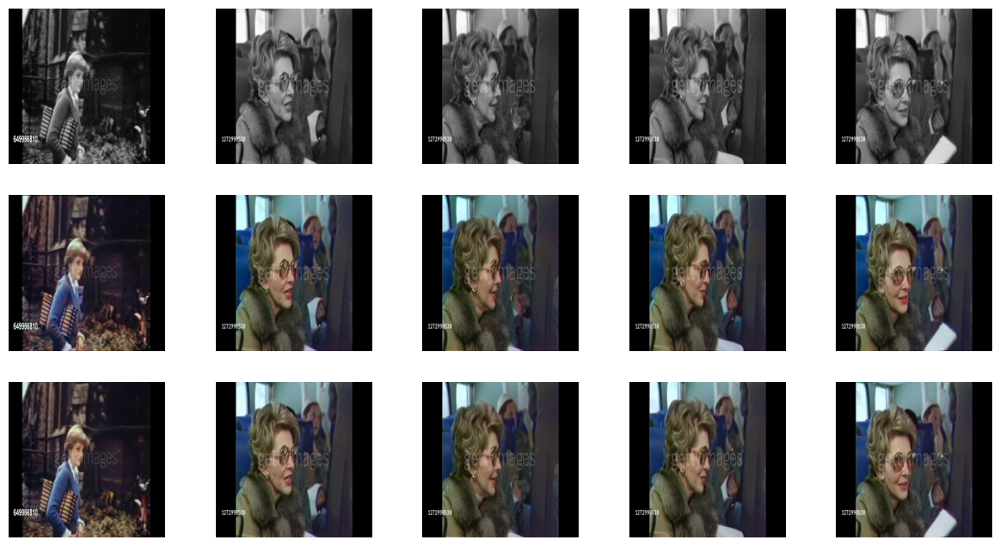

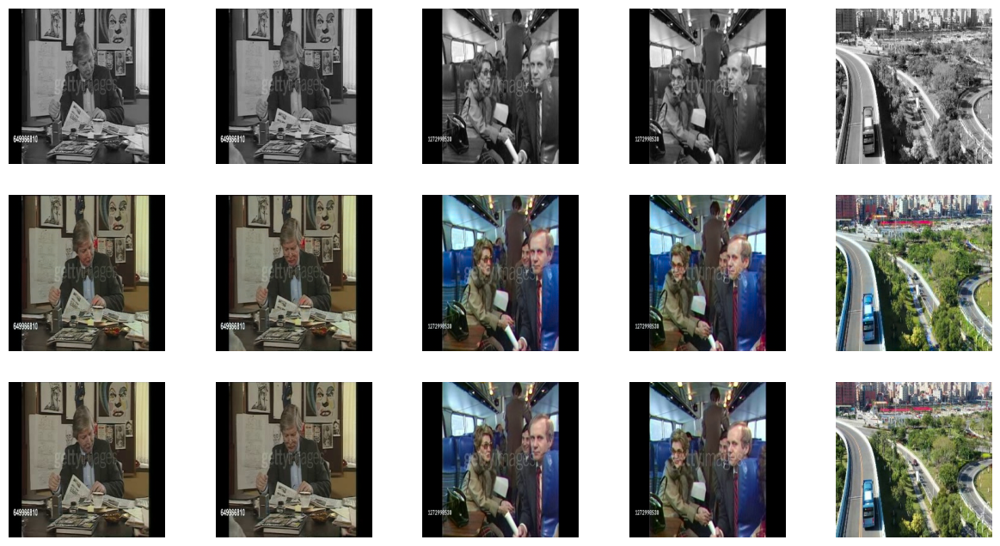

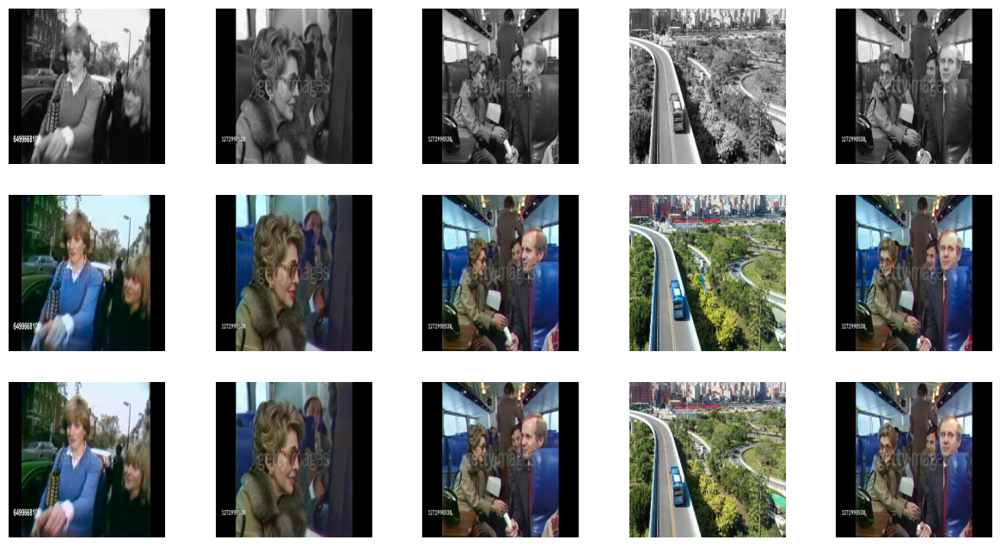

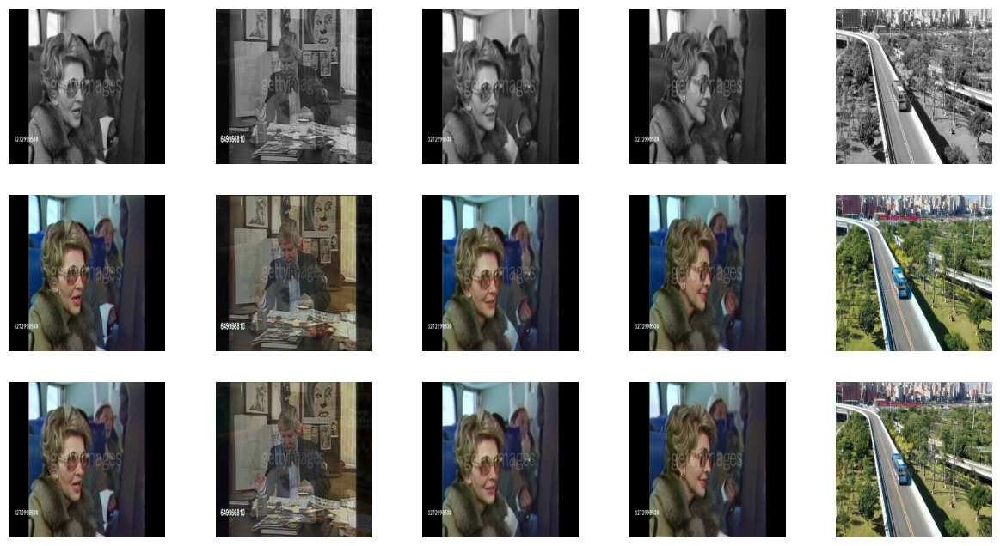

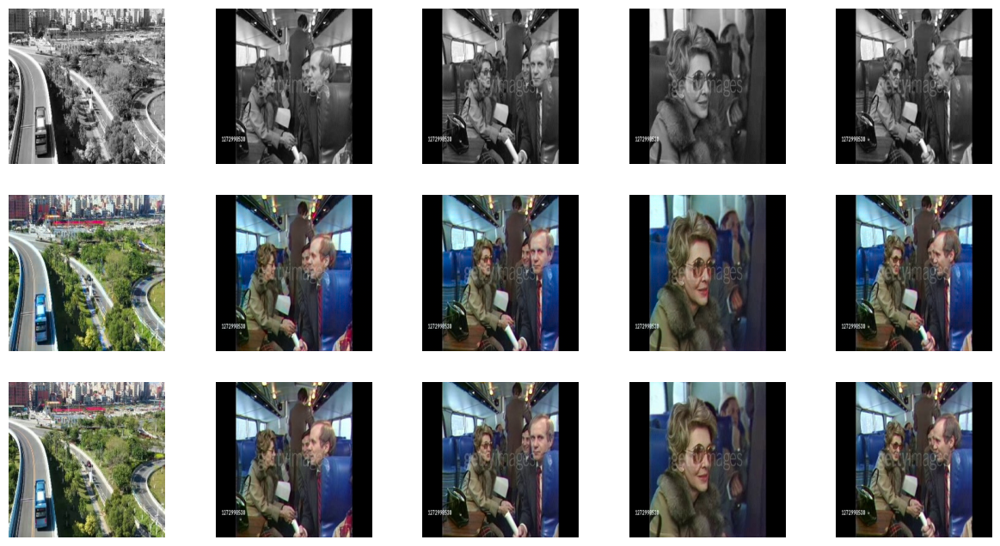

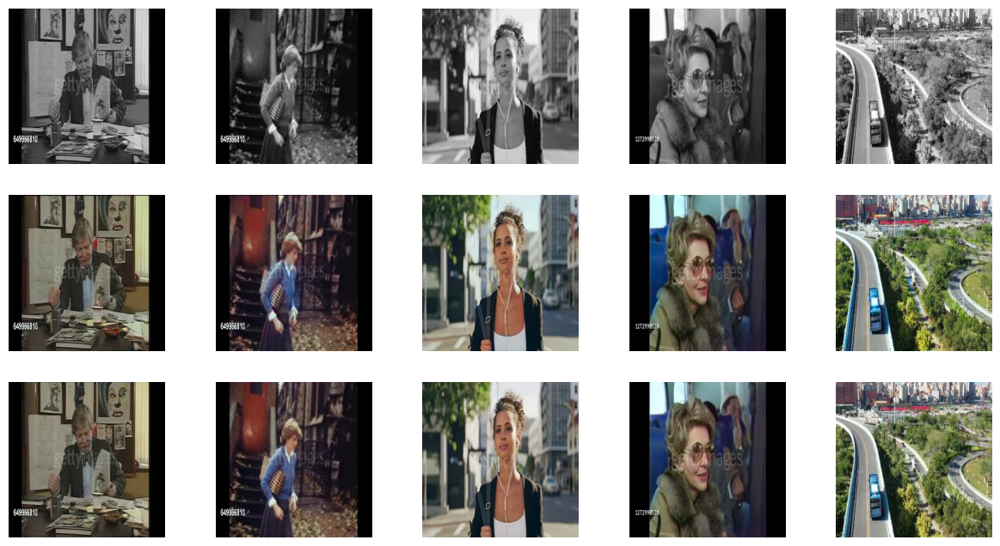

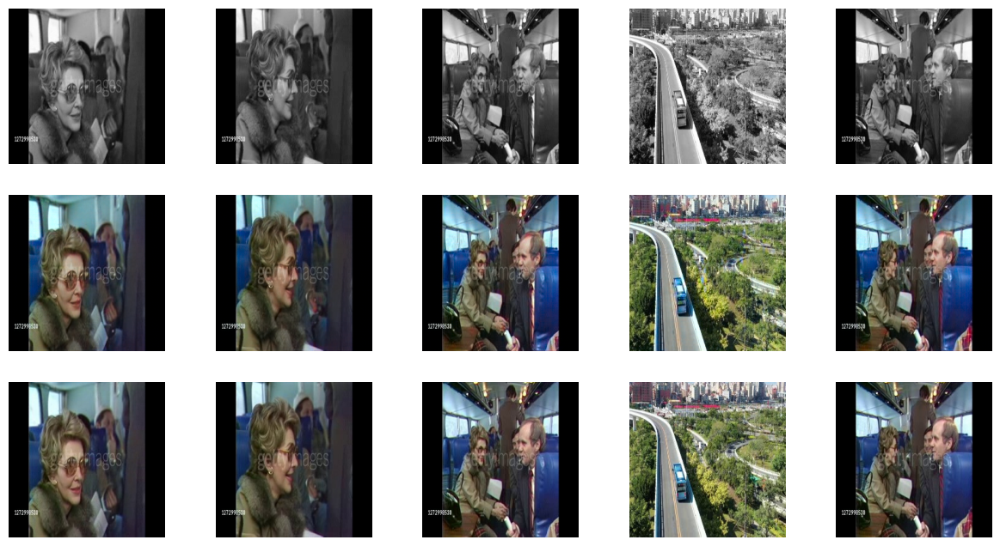

/tmp/ipykernel_34/2912172730.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 3 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
/tmp/ipykernel_34/2912172730.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 6 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


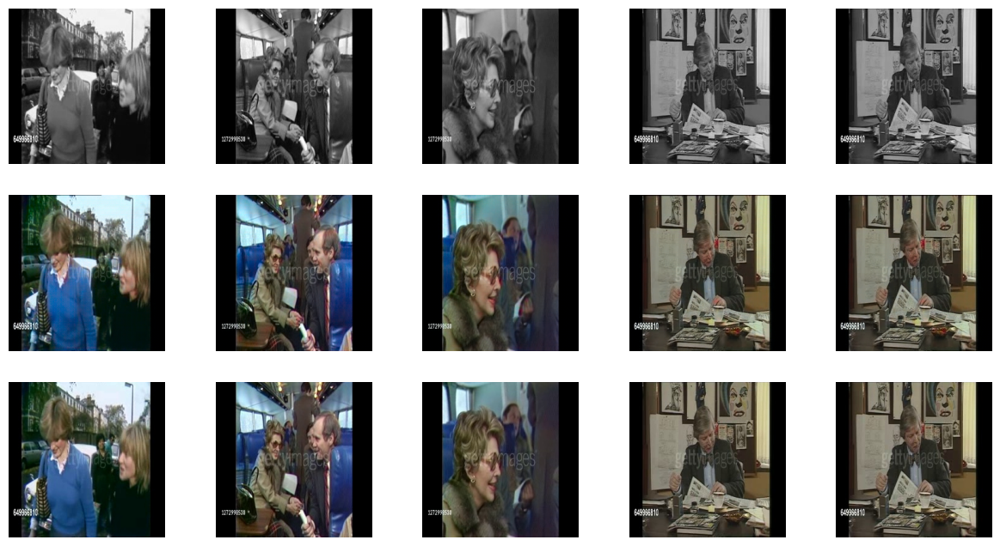

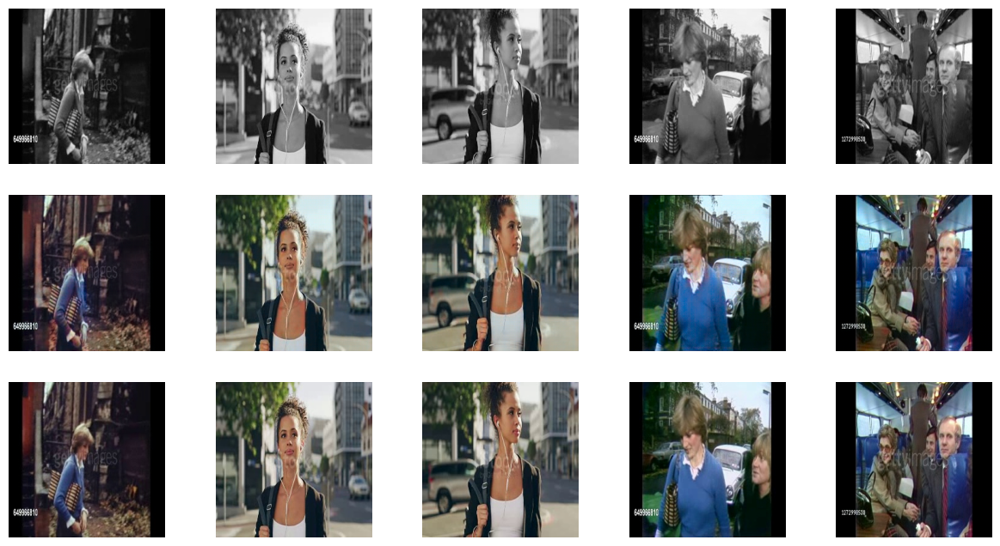

In [ ]:
for data,_ in tqdm(zip(val_dl,range(10))):
    visualize(model, data, save=True) # function displaying the model's outputs
            

In [ ]:
image_path = '/kaggle/input/image-1/bwimage.jpeg'

In [ ]:
import torch
import torchvision.transforms as transforms
from PIL import Image
import numpy as np
from skimage.color import rgb2lab


def load_image(image_path, device=torch.device("cpu")):
    """Load image from disk, convert it to LAB color space, and convert to a tensor."""
    transform = transforms.Compose([
                transforms.Resize((SIZE, SIZE),  Image.BICUBIC),
            ])

    img = Image.open(image_path).convert("RGB")
    img = transform(img)
    img = np.array(img)
    img_lab = rgb2lab(img).astype("float32") # Converting RGB to L*a*b
    img_lab = transforms.ToTensor()(img_lab)
    L = img_lab[[0], ...] / 50. - 1. # Between -1 and 1

    return L.unsqueeze(0).to(device) , L.to('cpu')

def display_colorization(model, image_path):
    """Display both the colorized and black-and-white versions of the image."""
    # Load the image
    image, l = load_image(image_path, device=model.device)
    
    
    print("image shape" ,image.shape)
    
    # Colorize the image using the model
    model.net_G.eval()
    with torch.no_grad():
        model.get_images(image)
        model.forward_data()
    model.net_G.train()
    fake_color = model.fake_color.detach()
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    
#     print(image.shape)
#     image = np.clip(image, 0, None)

    fake_imgs = fake_imgs.squeeze()
    
    # Display the images
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    axes[0].imshow(Image.open(image_path))
    axes[0].set_title("Original Image")
    axes[0].axis("off")
    axes[1].imshow(fake_imgs)
    axes[1].set_title("Colorized Image")
    axes[1].axis("off")
    plt.show()

display_colorization(model, image_path)



In [ ]:
img_path = coco_path+'/'+'000000347055.jpg'

In [ ]:
display_colorization(model, img_path)